In [1]:
import torch.utils.data as Data
import torch
import torch.optim as optim
from tqdm import tqdm
import torchvision.transforms as T
from torchvision.datasets import LFWPeople, LFWPairs, ImageFolder
import os
from scipy import ndimage
import numpy as np
from PIL.ImageEnhance import *
from torchvision.transforms import *
import random
from skimage import transform as trans
from mtcnn_pytorch.src import detect_faces, show_bboxes
from PIL import Image
import cv2
import numpy as np
from mtcnn_pytorch.src.align_trans import get_reference_facial_points, warp_and_crop_face

from models.inception_resnet_v1 import InceptionResnetV1

/home/weicheng/anaconda3/envs/UA/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
lfw_people = ImageFolder(root='/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled', 
                       transform=T.Compose([
                T.Resize(size=(160,160)),
                # T.RandomHorizontalFlip(0.5),
                # T.RandomRotation(degrees=10, interpolation=InterpolationMode.BILINEAR),
                T.ToTensor(),
                # T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ]))

In [3]:
def process_ndarray(img1_cv2):
    for i in range(img1_cv2.shape[0]):
        img = img1_cv2[i].squeeze() * 255
        img = img.astype(np.uint8)
        img = Image.fromarray(img)
        # print(img.size)
        src = np.array([                                                                                                                                                                     
            [30.2946, 51.6963],                                                                                                                                                                
            [65.5318, 51.5014],                                                                                                                                                                
            [48.0252, 71.7366],                                                                                                                                                                
            [33.5493, 92.3655],                                                                                                                                                                
            [62.7299, 92.2041] ], dtype=np.float32 )
        src[:,0] *= (img.size[0]/96)
        src[:,1] *= (img.size[1]/112)
        _, landmarks = detect_faces(img)
        # print(landmarks)
        dst = landmarks[0].astype(np.float32)
        facial5points = [[dst[j],dst[j+5]] for j in range(5)]
        tform = trans.SimilarityTransform()                                                                                                                     
        tform.estimate(np.array(facial5points), src)
        M = tform.params[0:2,:]
        warped = cv2.warpAffine(img1_cv2[i].squeeze(),M,(img.size[0],img.size[1]), borderValue = 0.0)
        img1_cv2[i] = warped
    return img1_cv2

In [4]:
loader = Data.DataLoader(
    dataset=lfw_people,
    batch_size=1,
    shuffle=False, drop_last=False)

In [5]:
resnet = InceptionResnetV1(classify=False, pretrained='vggface2')
resnet = resnet.cuda(0)
resnet.load_state_dict(torch.load('../model_mtcnn/epoch_10.pth'))
resnet.eval()

InceptionResnetV1(
  (conv2d_1a): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_2a): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_2b): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (maxpool_3a): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2d_3b): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_4a): 

In [6]:
features = []
images = []
labels = []
for step, (batch_x, batch_y) in enumerate(tqdm(loader)):
    inputs, label = batch_x, batch_y
    img1 = inputs.view(inputs.shape[0], inputs.shape[2], inputs.shape[3], inputs.shape[1])
    img1_cv2 = img1.numpy()
    img1_cv2 = process_ndarray(img1_cv2)
    img1 = torch.FloatTensor(img1_cv2)
    img1 = img1.view(img1.shape[0], img1.shape[3], img1.shape[1], img1.shape[2])
    pred1, output1 = resnet(img1.cuda())
    features.append(pred1.detach().cpu().numpy())
    images.append(img1.cpu().numpy())
    labels.append(label)
features = np.array(features)
images = np.array(images)
labels = np.array(labels)
np.savez(file='results.npz', features=features, images=images, labels=labels)
    # print(labels)

  0%|          | 0/13233 [00:00<?, ?it/s]/home/weicheng/anaconda3/envs/UA/lib/python3.10/site-packages/torch/nn/functional.py:780: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"
100%|██████████| 13233/13233 [12:55<00:00, 17.06it/s]
/tmp/ipykernel_2220769/20400388.py:17: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  labels = np.array(labels)
/tmp/ipykernel_2220769/20400388.py:17: VisibleDeprecat

In [6]:
image_test_path = [
    '/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Albert_Costa/Albert_Costa_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Angela_Bassett/Angela_Bassett_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Arminio_Fraga/Arminio_Fraga_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Billy_Crystal/Billy_Crystal_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Bob_Graham/Bob_Graham_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Boris_Becker/Boris_Becker_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Bulent_Ecevit/Bulent_Ecevit_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Calista_Flockhart/Calista_Flockhart_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Cameron_Diaz/Cameron_Diaz_0001.jpg',
'/home/weicheng/selfLearning/facenet/project/lfw/lfw-py/lfw_funneled/Carmen_Electra/Carmen_Electra_0001.jpg']

In [7]:
image_test = []
for i in image_test_path:
    img = np.asarray(Image.open(i))
    image_test.append(img)
image_test = np.array(image_test)
print(image_test.shape)
print(np.max(image_test))

(10, 250, 250, 3)
255


In [8]:
image_test = process_ndarray(image_test/255)

/home/weicheng/anaconda3/envs/UA/lib/python3.10/site-packages/torch/nn/functional.py:780: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


In [9]:
image_test = torch.FloatTensor(image_test)
image_test = image_test.view(image_test.shape[0], image_test.shape[3], image_test.shape[1], image_test.shape[2])
image_test = torch.nn.functional.interpolate(image_test, size=[160, 160])
print(image_test.shape)

torch.Size([10, 3, 160, 160])


In [10]:
feature, output = resnet(image_test.cuda())

In [11]:
results = np.load('results.npz')

all_features = torch.FloatTensor(results['features']).squeeze()
all_images = torch.FloatTensor(results['images']).squeeze()
print(all_features.shape)
print(all_images.shape)

torch.Size([13233, 512])
torch.Size([13233, 3, 160, 160])


In [12]:
all_logits = torch.cdist(feature.cpu(), all_features)
print(all_logits.shape)
_, nn_index = all_logits.topk(20, dim=1, largest=False)
print(nn_index.shape)
retrieved_images = all_images[nn_index]
print(retrieved_images.shape)
retrieved_images = retrieved_images.flatten(0, 1)
retrieved_images = retrieved_images.view(retrieved_images.shape[0], retrieved_images.shape[2], retrieved_images.shape[3], retrieved_images.shape[1])
print(retrieved_images.shape)

torch.Size([10, 13233])
torch.Size([10, 20])
torch.Size([10, 20, 3, 160, 160])
torch.Size([200, 160, 160, 3])


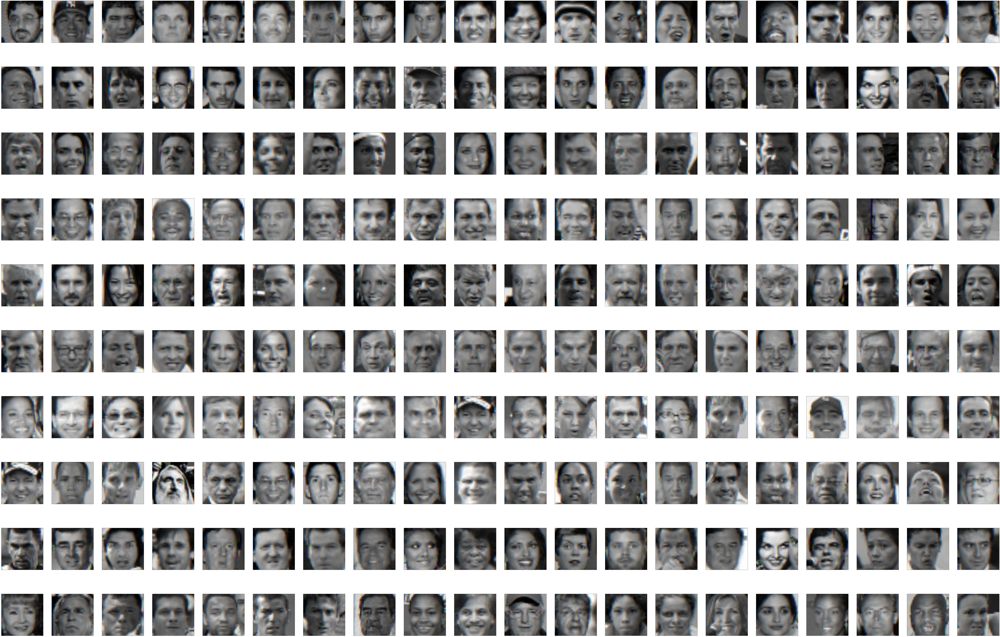

In [13]:
import  matplotlib.pyplot as plt
plt.figure(figsize=(150,100))
for i in range(1, 201):
    plt.subplot(10, 20, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(retrieved_images[i-1])
plt.show()